# Replot Thesis Figure 4.6

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from corr_utils import *
# from mayavi import mlab
import matplotlib as mpl
import typesetting.main as tm

In [85]:
mpl.rcParams['text.usetex'] = True

0.6611876910101098
0.7640128488381694
0.7504729625595744
0.7881866580310793
0.8081909572418172
0.8319531944891289
0.8411727930372501
0.857059123331471
0.8680861218318525
0.8382663864884043
0.8437529753908406
0.8348750554025031
0.8389231166223502
0.8516421805342911
0.857249885989674
0.8543475927108222
0.8591165745172785
0.8475221317634799
0.853649595958569
0.8218428681940146
0.8454448212587936


E:\anaconda\miniconda\lib\site-packages\ipykernel_launcher.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


0.8594498833700599
0.826654413469055
0.846489367129017
0.8680205477536491
0.8469117210617829
0.8229006725307608
0.8540172536740815
0.8342598822051907
0.8255352626161163
0.8358942030161952
0.8267177366186436
0.8357976409669783
0.83412148868778
0.8295834384942522
0.8206320322152141
0.8416625389111866
0.8174146423199031
0.8492709582872476
0.8687593068299136
0.8537275756659558
0.8234605799091138
0.8660827916035135
0.8467633305450822
0.8647065423490282
0.828373501667345
0.8222932137328463
0.8274368122722557
0.8228244784997978
0.8123671128932776
0.8404905633789901
0.8265175663579117
0.8324951428163098
0.8139047284955288
0.8051062846058232
0.8539879708800442
0.8251928725890731
0.8645118446626655
0.8246374876849039
0.8244170649220388
0.8364524767530896
0.8341860099767557
0.8105087397093904
0.8261835662512554
0.8395510928986638
0.840135379175444


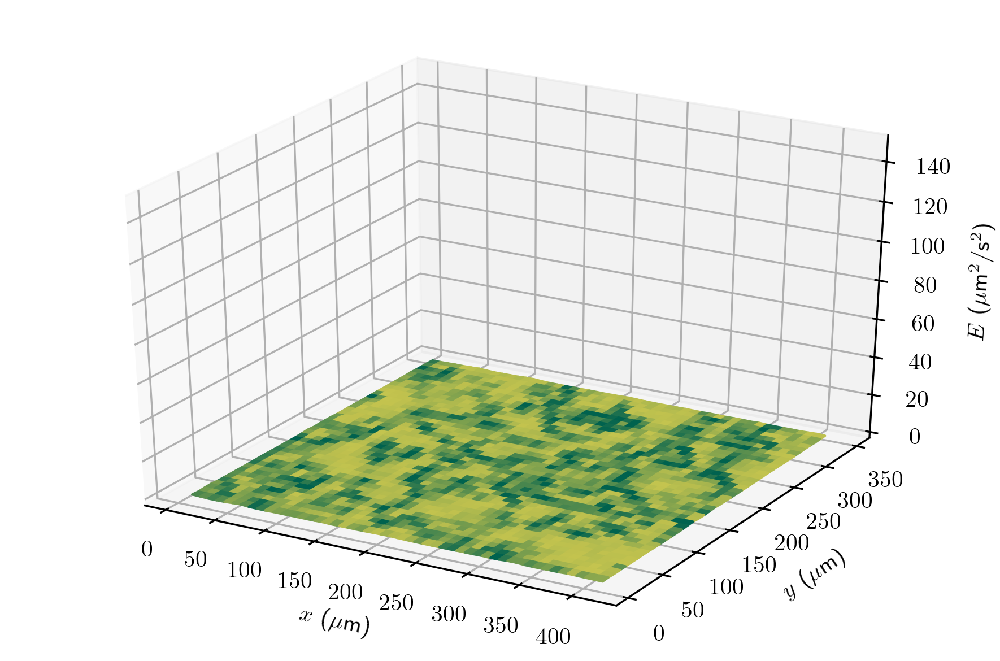

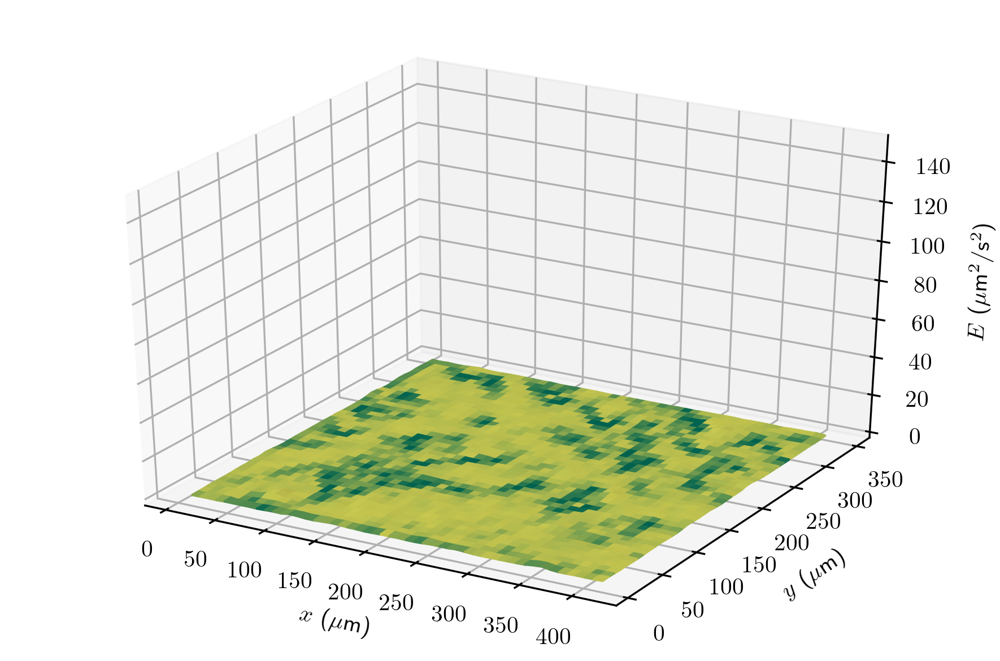

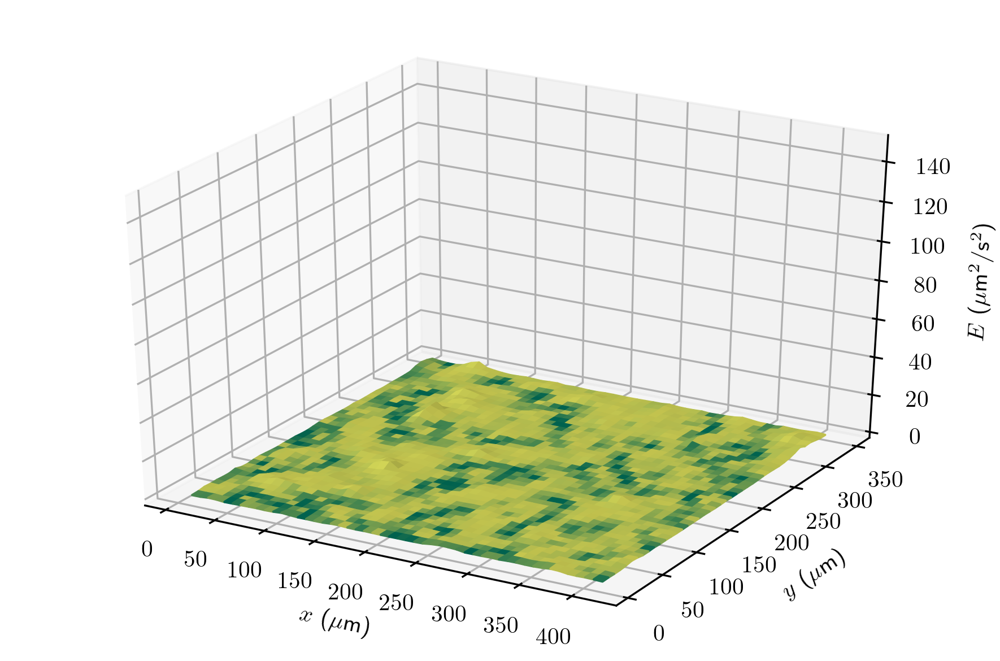

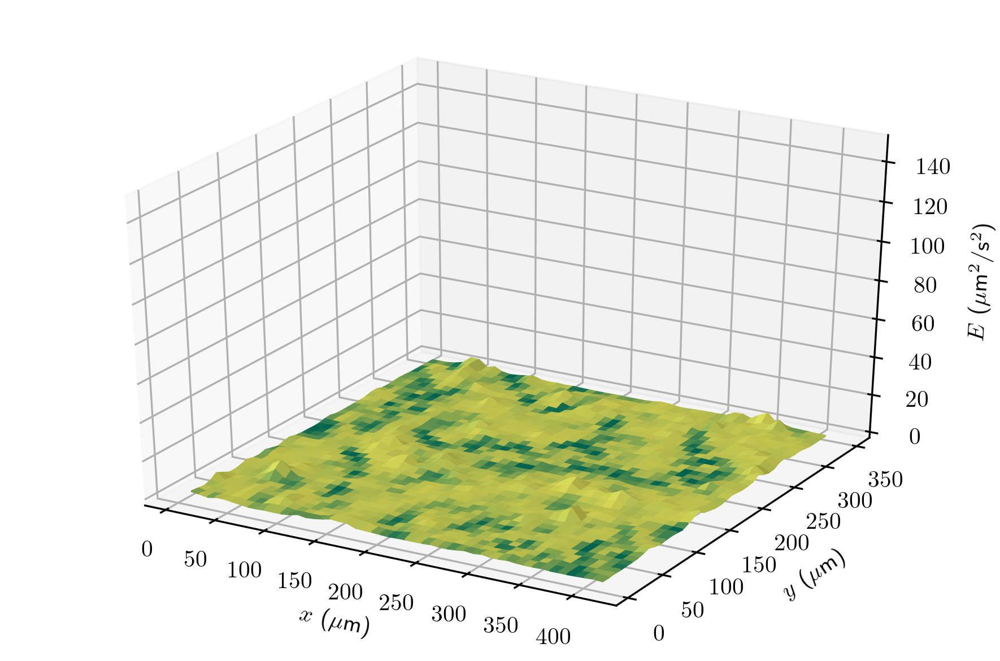

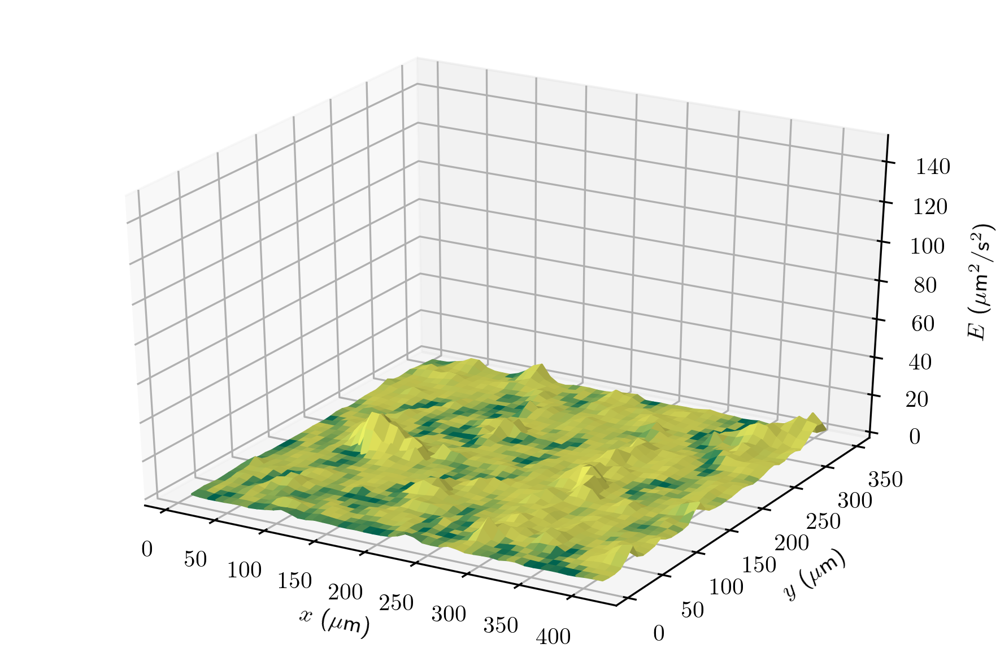

...

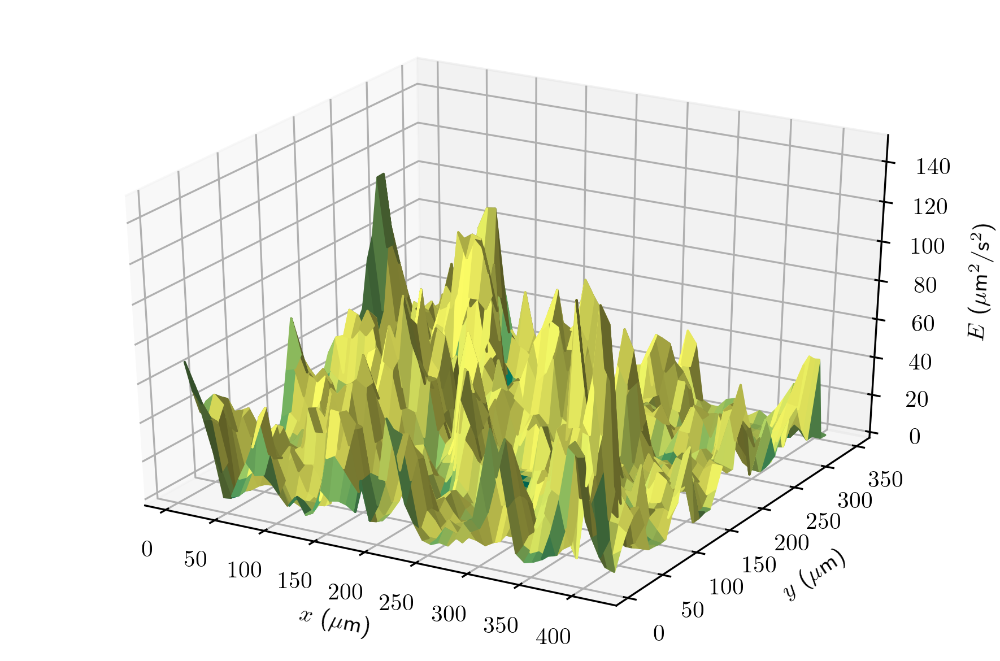

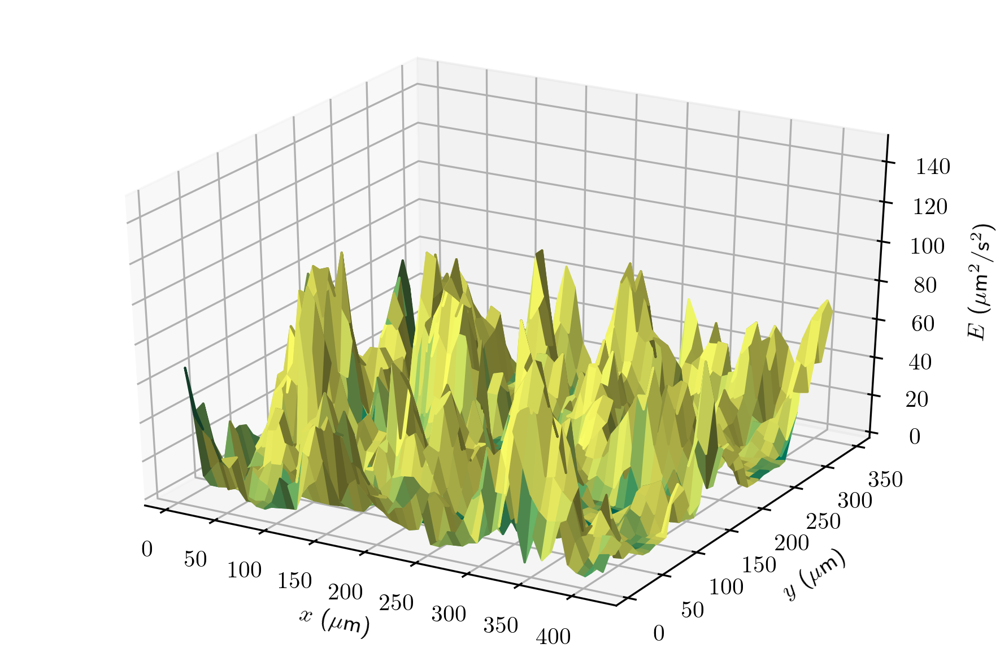

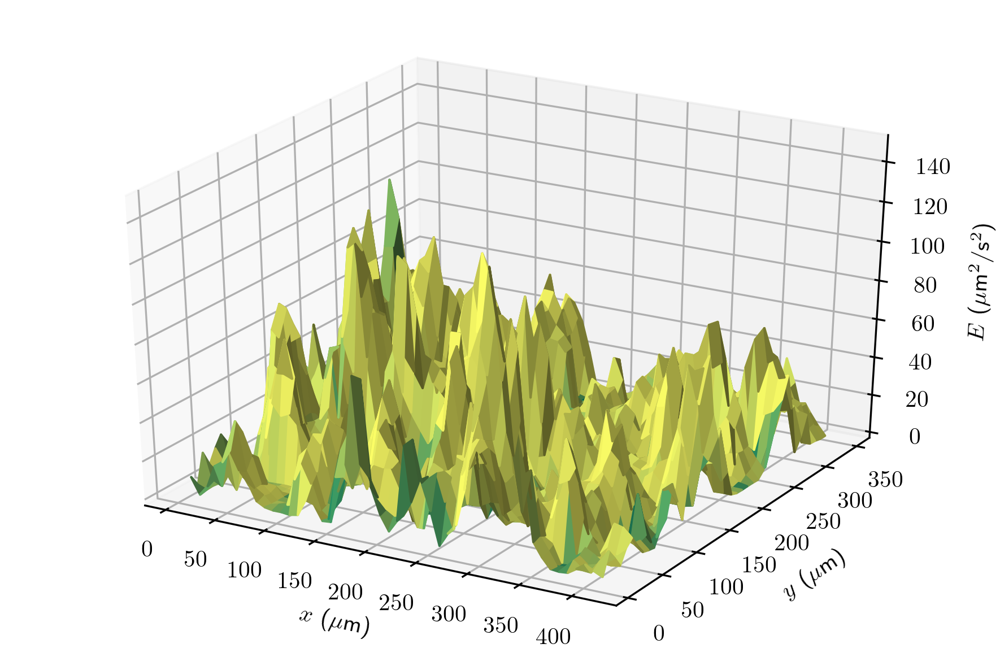

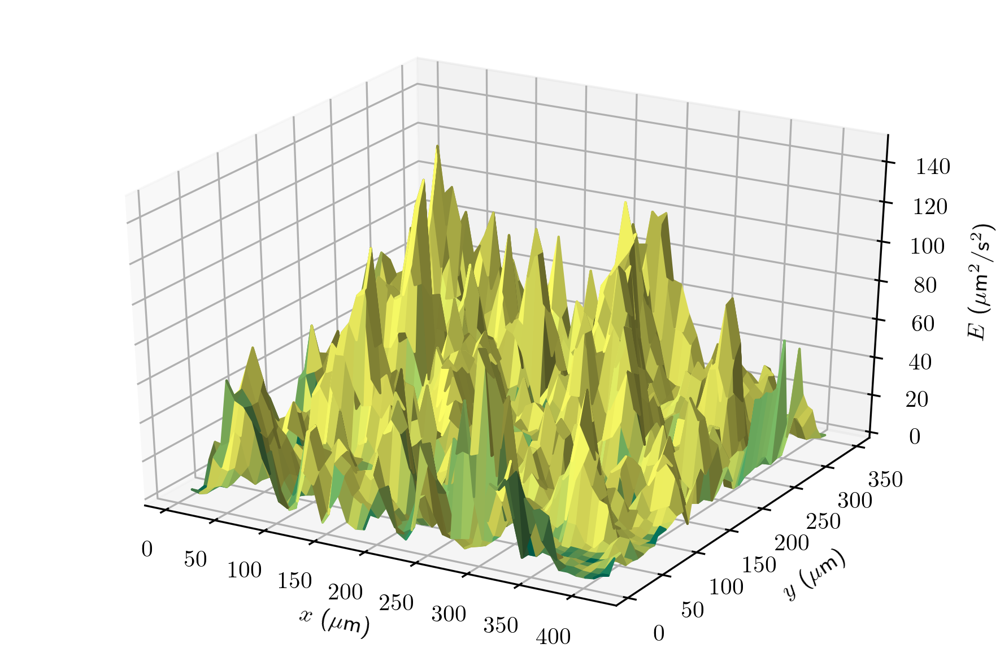

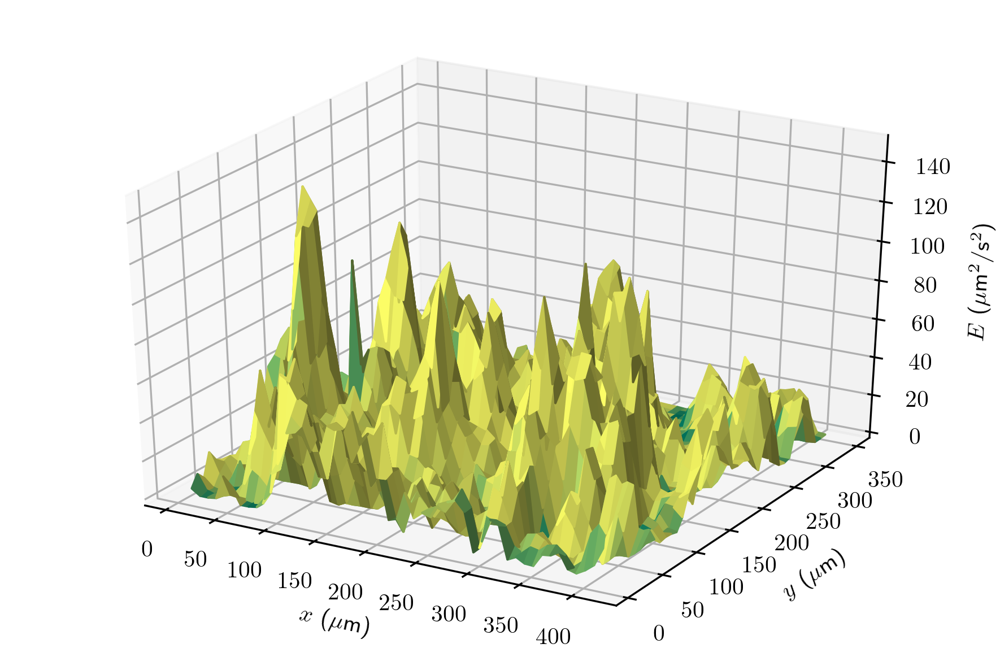

In [96]:
for n in range(200, 3500, 50):
    MPP = 0.33
    pivData = pd.read_csv(r'E:\moreData\08032020\piv_imseq\08\{0:04d}-{1:04d}.csv'.format(n, n+1))
    X, Y, U, V = read_piv(r'E:\moreData\08032020\piv_imseq\08\{0:04d}-{1:04d}.csv'.format(n, n+1))
    order = order_field(pivData)
    E = (U ** 2 + V ** 2) / 2 * MPP * MPP
    print(order.mean())

    # order_norm = (order + 1) / (order.max() + 1)
    order[order<0.8] *= 0.9
    hot = mpl.cm.get_cmap('summer')
    colors_pre = np.expand_dims(order, axis=2)
    colors = np.pad(colors_pre, ((0,0),(0,0),(0,3)), mode='constant', constant_values=((0,0),(0,0),(0,0)))

    # convert colors from hsv to rgb
    colors_rgb = colors
    for i in range(0, colors.shape[0]):
        for j in range(0, colors.shape[1]):
            colors_rgb[i, j] = hot(colors[i, j, 0])

    fig = plt.figure(dpi=300)
    mpl.rcParams['font.size'] = 10
    # mpl.rcParams['axes.labelpad'] = 0
    ax = fig.gca(projection='3d')
    ax.plot_surface(X*MPP, Y*MPP, E, facecolors=colors_rgb)
    ax.set_zlim([0, 150])
    ax.set_xlabel('$x$ ($\mu$m)')
    ax.set_ylabel('$y$ ($\mu$m)')
    ax.set_zlabel('$E$ ($\mu$m$^2$/s$^2$)')
    plt.tight_layout()
    fig.savefig(r'E:\moreData\08032020\energy_order_plot\08\jpg\{:04d}.jpg'.format(n))

In [3]:
def order_field(pivData):
    """
    Compute local order from pivData.
    
    Args:
    pivData -- DataFrame containing (x, y, u, v)
    
    Returns:
    order -- order field, an array of the shape of given velocity field
    """
    def inner(Ax, Ay, Bx, By):
        """
        define inner product between two matrices
        """
        return (Ax*Bx + Ay*By) / (Ax**2+Ay**2)**0.5 / (Bx**2+By**2)**0.5
    col = len(pivData.x.drop_duplicates())
    row = len(pivData.y.drop_duplicates())
    u = np.array(pivData.u).reshape((row, col))
    v = np.array(pivData.v).reshape((row, col))
    u1 = np.roll(u, -1, axis=0) # up
    v1 = np.roll(v, -1, axis=0) # up
    u2 = np.roll(u, 1, axis=0) # down
    v2 = np.roll(v, 1, axis=0) # down
    u3 = np.roll(u, 1, axis=1) # right
    v3 = np.roll(v, 1, axis=1) # right
    u4 = np.roll(u, -1, axis=1) # left
    v4 = np.roll(v, -1, axis=1) # left
    
    # do inner products with original matrix
    I1 = inner(u, v, u1, v1)
    I2 = inner(u, v, u2, v2)
    I3 = inner(u, v, u3, v3)
    I4 = inner(u, v, u4, v4)
    
    # average the products
    order = (I1 + I2 + I3 + I4) / 4
    
    order_stack = np.stack([I1, I2, I3, I4], axis=0)
    order_min = np.amin(order_stack, axis=0)
    
    return order_min